***
# <div align="center">Speaker Diarization, Transcription & Speech-To-Text</div>
#### <div align="right">DHIVAKAR K<br>CB.EN.U4CSE18314</div>
#### <div align="right">Gillella Sai Shanthan Reddy<br>CB.EN.U4CSE18221</div>
#### <div align="right">A Sai Tharun<br>CB.EN.U4CSE18250</div>
#### <div align="right">M SAI GHOWTHAM<br>CB.EN.U4CSE18338</div>
***

## Importing required Libraries

In [98]:
import librosa

#Importing Wav2Vec tokenizer
from transformers import Wav2Vec2ForCTC, Wav2Vec2Processor, Speech2TextProcessor, Speech2TextForConditionalGeneration

from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.cluster import AgglomerativeClustering

from sklearn.manifold import TSNE

import numpy as np
import matplotlib
import matplotlib.pyplot as plt
 
import torch
    
import fpdf

import IPython.display as display
import ipywidgets as widgets
from ipywidgets import IntProgress
import time

from tkinter import Tk, filedialog

import time

import soundfile as sf

from datasets import load_dataset
from punctuator import Punctuator

from pyannote.audio.utils.signal import Peak, Binarize
from pyannote.core import Timeline,Segment

from pyannote.pipeline.parameter import Categorical, Uniform
from pyannote.core.utils.hierarchy import linkage

from pyannote.database import Protocol

from spectralcluster import SpectralClusterer
from scipy.spatial.distance import cosine

from jiwer import wer

from functools import partial

try:
    from functools import cached_property
except ImportError:
    from backports.cached_property import cached_property
    
from __future__ import annotations

from functools import partial

try:
    from functools import cached_property
except ImportError:
    from backports.cached_property import cached_property

import multiprocessing
from dataclasses import dataclass
from enum import Enum
from numbers import Number

from pyannote.database import Protocol
from torch.utils.data import DataLoader, Dataset, IterableDataset
from torch_audiomentations import Identity
from torch_audiomentations.core.transforms_interface import BaseWaveformTransform
from torchmetrics import Metric, MetricCollection
from typing_extensions import Literal

import warnings
warnings.simplefilter(action = 'ignore', category=FutureWarning)
warnings.filterwarnings('ignore')
def ignore_warn(*args, **kwargs):
    pass
warnings.warn = ignore_warn

***
### Some Sample Clips For Testing

In [2]:
audio, rate = librosa.load("D:/BraveDownloads/taken_clip.wav", sr = 16000)
display.Audio(data=audio.squeeze(), rate=rate, autoplay=False)

In [3]:
audio1, rate = librosa.load("D:/BraveDownloads/Jordan Peterson Confronts Australian Politician on Gender Politics and Quotas _ Q&A.wav", sr = 16000, offset=100.0, duration=30.0)
display.Audio(data=audio1.squeeze(), rate=rate, autoplay=False)

In [4]:
audio2, rate = librosa.load("D:/BraveDownloads/NDTV Exclusive - Rahul Gandhi's First TV Interview This Election Season.wav", sr = 16000, offset=0, duration=30.0)
display.Audio(data=audio2.squeeze(), rate=rate, autoplay=False)

In [5]:
audio3, rate = librosa.load("D:/BraveDownloads/8q7vg-909qk.wav", sr = 16000)
display.Audio(data=audio3.squeeze(), rate=rate, autoplay=False)

In [6]:
sad = torch.hub.load('pyannote/pyannote-audio', 'sad_ami')
scd = torch.hub.load('pyannote/pyannote-audio', 'scd_ami')
emb = torch.hub.load('pyannote/pyannote-audio', 'emb_ami')
ovl = torch.hub.load('pyannote/pyannote-audio', 'ovl_ami')

Using cache found in C:\Users\dhiva/.cache\torch\hub\pyannote_pyannote-audio_master
Using cache found in C:\Users\dhiva/.cache\torch\hub\pyannote_pyannote-audio_master
Using cache found in C:\Users\dhiva/.cache\torch\hub\pyannote_pyannote-audio_master
Using cache found in C:\Users\dhiva/.cache\torch\hub\pyannote_pyannote-audio_master


***
## Speech To Text

In [7]:
base_960h_processor = Wav2Vec2Processor.from_pretrained("facebook/wav2vec2-base-960h",cache_dir="D:\\Study\\Sem7\\Final Year\\cache\\models\\base-960h")
base_960h_model = Wav2Vec2ForCTC.from_pretrained("facebook/wav2vec2-base-960h",cache_dir="D:\\Study\\Sem7\\Final Year\\cache\\models\\base-960h")

Some weights of Wav2Vec2ForCTC were not initialized from the model checkpoint at facebook/wav2vec2-base-960h and are newly initialized: ['wav2vec2.masked_spec_embed']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [8]:
large_960h_processor = Wav2Vec2Processor.from_pretrained("facebook/wav2vec2-large-960h",cache_dir="D:\\Study\\Sem7\\Final Year\\cache\\models\\large-960h")
large_960h_model = Wav2Vec2ForCTC.from_pretrained("facebook/wav2vec2-large-960h",cache_dir="D:\\Study\\Sem7\\Final Year\\cache\\models\\large-960h")

Some weights of Wav2Vec2ForCTC were not initialized from the model checkpoint at facebook/wav2vec2-large-960h and are newly initialized: ['wav2vec2.masked_spec_embed']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [9]:
pro_960h_processor = Wav2Vec2Processor.from_pretrained("facebook/wav2vec2-large-960h-lv60-self",cache_dir="D:\\Study\\Sem7\\Final Year\\cache\\models\\pro-960h")
pro_960h_model = Wav2Vec2ForCTC.from_pretrained("facebook/wav2vec2-large-960h-lv60-self",cache_dir="D:\\Study\\Sem7\\Final Year\\cache\\models\\pro-960h")

Some weights of Wav2Vec2ForCTC were not initialized from the model checkpoint at facebook/wav2vec2-large-960h-lv60-self and are newly initialized: ['wav2vec2.masked_spec_embed']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [10]:
s21_small_model = Speech2TextForConditionalGeneration.from_pretrained("facebook/s2t-small-librispeech-asr",cache_dir="D:\\Study\\Sem7\\Final Year\\cache\\models\\s21-small")
s21_small_processor = Speech2TextProcessor.from_pretrained("facebook/s2t-small-librispeech-asr",cache_dir="D:\\Study\\Sem7\\Final Year\\cache\\models\\s21-small")

In [11]:
def map_to_array(batch):
    speech, _ = sf.read(batch["file"])
    batch["speech"] = speech
    return batch

librispeech_eval = load_dataset("hf-internal-testing/librispeech_asr_dummy", "clean", split="validation",cache_dir="D:\\Study\\Sem7\\Final Year\\cache\\datasets\\lad")

Reusing dataset librispeech_asr (D:\Study\Sem7\Final Year\cache\datasets\lad\hf-internal-testing___librispeech_asr\clean\2.1.0\d3bc4c2bc2078fcde3ad0f0f635862e4c0fef78ba94c4a34c4c250a097af240b)


In [12]:
models=[[base_960h_processor,base_960h_model,"facebook/wav2vec2-base-960h"],[large_960h_processor,large_960h_model,"facebook/wav2vec2-large-960h"],[pro_960h_processor,pro_960h_model,"facebook/wav2vec2-large-960h-lv60-self"]]

In [13]:
modelo=[s21_small_processor,s21_small_model,"facebook/s2t-small-librispeech-asr"]

In [14]:
librispeech_eval = librispeech_eval.map(map_to_array)
librispeech_eval.features

Loading cached processed dataset at D:\Study\Sem7\Final Year\cache\datasets\lad\hf-internal-testing___librispeech_asr\clean\2.1.0\d3bc4c2bc2078fcde3ad0f0f635862e4c0fef78ba94c4a34c4c250a097af240b\cache-b2a5ca767e51a61f.arrow


{'file': Value(dtype='string', id=None),
 'audio': Audio(sampling_rate=16000, mono=True, decode=True, id=None),
 'text': Value(dtype='string', id=None),
 'speaker_id': Value(dtype='int64', id=None),
 'chapter_id': Value(dtype='int64', id=None),
 'id': Value(dtype='string', id=None),
 'speech': Sequence(feature=Value(dtype='float64', id=None), length=-1, id=None)}

In [15]:
for model in models:
    def map_to_pred(batch):
        input_values = model[0](batch["speech"], sampling_rate=16000, return_tensors="pt", padding="longest").input_values
        with torch.no_grad():
            logits = model[1](input_values).logits

        predicted_ids = torch.argmax(logits, dim=-1)
        transcription = model[0].batch_decode(predicted_ids)
        batch["transcription"] = transcription
        return batch

    result = librispeech_eval.map(map_to_pred, batched=True, batch_size=1, remove_columns=["speech"])

    print(model[2],"WER:", wer(result["text"], result["transcription"]))

  0%|          | 0/73 [00:00<?, ?ba/s]

facebook/wav2vec2-base-960h WER: 0.05304347826086957


  0%|          | 0/73 [00:00<?, ?ba/s]

facebook/wav2vec2-large-960h WER: 0.03826086956521739


Parameter 'function'=<function map_to_pred at 0x000001ACE282DE50> of the transform datasets.arrow_dataset.Dataset._map_single couldn't be hashed properly, a random hash was used instead. Make sure your transforms and parameters are serializable with pickle or dill for the dataset fingerprinting and caching to work. If you reuse this transform, the caching mechanism will consider it to be different from the previous calls and recompute everything. This warning is only showed once. Subsequent hashing failures won't be showed.


  0%|          | 0/73 [00:00<?, ?ba/s]

facebook/wav2vec2-large-960h-lv60-self WER: 0.03304347826086956


In [16]:
def map_to_pred(batch):
    features = s21_small_processor(batch["speech"], sampling_rate=16000, padding=True, return_tensors="pt")
    input_features = features.input_features
    attention_mask = features.attention_mask

    gen_tokens = s21_small_model.generate(inputs=input_features, attention_mask=attention_mask)
    batch["transcription"] = list(map(lambda x: x.upper(),s21_small_processor.batch_decode(gen_tokens, skip_special_tokens=True)))
    return batch

result = librispeech_eval.map(map_to_pred, batched=True, batch_size=1, remove_columns=["speech","id"])

print(modelo[2],"WER:", wer(result["text"], result["transcription"]))

  0%|          | 0/73 [00:00<?, ?ba/s]

facebook/s2t-small-librispeech-asr WER: 0.06173913043478261


In [17]:
for model in models:
    input_values = model[0](audio3, return_tensors="pt", padding="longest",sampling_rate=rate).input_values
    print("\n",model[2])
    with torch.no_grad():
        logits = model[1](input_values).logits
    prediction = torch.argmax(logits, dim = -1)
    transcription = model[0].batch_decode(prediction)[0]
    print('\n',transcription)
    
print("\n",modelo[2])
inputs = s21_small_processor(audio3, sampling_rate=16_000, return_tensors="pt")
generated_ids = s21_small_model.generate(inputs=inputs["input_features"], attention_mask=inputs["attention_mask"])
transcription = s21_small_processor.batch_decode(generated_ids)
print('\n',transcription)
display.Audio(data=audio3.squeeze(), rate=rate, autoplay=False)


 facebook/wav2vec2-base-960h

 PACT IN YOU HAS EDUCATION IND GUBL HEALTH I WAS GOBLE HEALTH BECAUSE OF SOME NEW VAXINES A THAT WE'VE BEEN AVOLVED WITHIN THOSE OF REARLY GOTTEN OUT WE IN A SWUN FOR THE FENCEIS THERE AND ACTUALLY AH IT SUCCEEDED EDUCATION'S BEEN A LOT TOUGHER WHERE A ALTHOUGH WE'VE DONE SOME GOOD CRICULUM AND DONE SOME THINGS FOR TUTORING AND KIDS GETTING FEED BACK IN WE DON'T HAVE A THE DROP OUTRAGED GRADUATION PREPAREDNESS STILL IN OF THE SYSTEM IS IS NOT DRAMATICALLY IMPROVED O NOERNEAR AS GOOD AS WE WANT TO BE I FELIKE YOUAYS SEEM TO SWING FOR THE FENCES IN GENERAL IS TO SURV ANY WAY OF FRAMING IT BUT I HAVE TO ASK IF YOU ARE SWINGINGFOR THE FENCES WHAT IF YOU MISS WELL HOPEFULLY I YOU GET MORE THAN ONE SWINGS YAH EITHER AT THE SAME PROBLEM LIKE IN A MULTIPLE MALLARI OF AXINE CONSTRACT SO THAT IN A  YOU HAVE TWO OR THREE THE COMBINED CHANCE SUCCESS MUCH HIGHER OR THAT YOURE WORKING IN MULTIPLE AREAS NOT JUST ONE AREA IN A INCLIMATE FOR EXAMPLE I HAVE ACCOMPANY THAT'

In [18]:
display.Audio(data=audio2.squeeze(), rate=rate, autoplay=False)
for model in models:
    input_values = model[0](audio2, return_tensors="pt", padding="longest",sampling_rate=rate).input_values
    print("\n",model[2])
    with torch.no_grad():
        logits = model[1](input_values).logits
    prediction = torch.argmax(logits, dim = -1)
    transcription = model[0].batch_decode(prediction)[0]
    print('\n',transcription)
    
print("\n",modelo[2])
inputs = s21_small_processor(audio2, sampling_rate=16_000, return_tensors="pt")
generated_ids = s21_small_model.generate(inputs=inputs["input_features"], attention_mask=inputs["attention_mask"])
transcription = s21_small_processor.batch_decode(generated_ids)
print('\n',transcription)


 facebook/wav2vec2-base-960h

 O KAS THIS IS THE BIG ENDYDEVI EXCLUSIVE WE ARE HERN IN RAGERS TAN WID RAHOL GANDEY WHOSE JUST FINISHED NOMOSCAD WAS JUST FINISHED THE RALLY AND IS GIVING I THINK THE FIRST DELEVATIEN INTERVIEW OFF THIS ELECTION SEASON WE CAN SEE ROUL AT THE BACK O THE CROW E JUST FINISHED AND THAT THEY'VE COME RIGHT UP TO WHERE YOU ARE BUT AGREET TO HAVE YOU WITH US ROW LIBEJUS ASK YOU AS A STARTING POINT QUESTION THAT

 facebook/wav2vec2-large-960h

 OKE THIS IS THE BIG ANDITIMI EXCLUSIVE WE ARE HERE IN RAJASTAN WITH RAHUL GANDI WHO'S JUST FINISHED NAMERSCART WASL JUST FINISHED TO RALLI A AND IS GIVING I THINK THE FIRST DELEVATIAN INTERVIEW OFF THIS ELECTION SEASON WE CAN SEE RAHOUL AT THE BACK A THE CROWDS ARE JUST FINISHED AND THEY THEY'VE COME RIGHT UP TO WHERE YOU ARE BUT THEY'RE AGREET TO HAVE YOU WITH US RAOUL LET ME JUST ASK YOU AS A STARTING POINT QUESTION THAT

 facebook/wav2vec2-large-960h-lv60-self

 O K THIS IS THE BIG ENTY TEAME EXCLUSIVE WE ARE HERE IN RA

In [19]:
def speechToText(audio,sampling_rate=16000):
    if audio is None or len(audio)<=0:
        return None
    input_values = pro_960h_processor(audio, return_tensors="pt", padding="longest", sampling_rate=sampling_rate).input_values
    with torch.no_grad():
        logits = pro_960h_model(input_values).logits
    prediction = torch.argmax(logits, dim = -1)
    return pro_960h_processor.batch_decode(prediction)[0].lower()

***
## Text Based Post Processing

Automatic Speech Recognition (ASR) systems typically generate text with no punctuation and capitalization of the words. There are two issues with non-punctuated ASR output:

* it could be difficult to read and understand

* models for some downstream tasks, such as named entity recognition, machine translation, or text-to-speech, are usually trained

* on punctuated datasets and using raw ASR output as the input to these models could deteriorate their performance

***
### Punctuation and Capitalization Model

A bidirectional recurrent neural network(RNN) model with attention mechanism for restoring missing inter-word punctuation and capitalisation in unsegmented text.

#### The approaches to the Capitalization problem:
* sentence segmentation: splitting the input text into sentences and up-casing the first word of each sentence.
* part-of-speech (POS) tagging: looking up the definition and context of each word within the sentence, and assigning the most appropriate tag. Finally, up-casing words with specific tags.
* name-entity-recognition (NER): by classifying words within a sentence to specific categories, and deciding to up-case e.g. person names, etc.
* statistical modeling: by training a statistical model on words and group of words which usually appear in capitalized format.

In [20]:
p = Punctuator('D:/Study/Sem7/Final Year/Transcription/.punctuator/Demo-Europarl-EN.pcl')

In [21]:
p2 = Punctuator('D:/Study/Sem7/Final Year/Transcription/.punctuator/INTERSPEECH-T-BRNN.pcl')

In [22]:
sample="winston is one of the most laid-back people i know he is tall and slim with black hair and he always wears a t-shirt and black jeans his jeans have holes in them and his baseball boots are scruffy too he usually sits at the back of the class and he often seems to be asleep however when the exam results are given out he always gets an \"A\" i don't think hes as lazy as he appears to be"

winston is one of the most laid-back people i know he is tall and slim with black hair and he always wears a t-shirt and black jeans his jeans have holes in them and his baseball boots are scruffy too he usually sits at the back of the class and he often seems to be asleep however when the exam results are given out he always gets an "A" i don't think hes as lazy as he appears to be

In [23]:
correctAnswer="Winston is one of the most laid-back people, I know He is tall and slim with black hair, and he always wears a t-shirt and black jeans. His jeans have holes in them, and his baseball boots are scruffy, too. He usually sits at the back of the class, and he often seems to be asleep. However, when the exam results are given out he always gets an \"A\". I don't think he's as lazy as he appears to be."

Winston is one of the most laid-back people, I know He is tall and slim with black hair, and he always wears a t-shirt and black jeans. His jeans have holes in them, and his baseball boots are scruffy, too. He usually sits at the back of the class, and he often seems to be asleep. However, when the exam results are given out he always gets an "A". I don't think he's as lazy as he appears to be.

In [24]:
p.punctuate(sample)

'Winston is one of the most laid-back people. I know he is tall and slim with black hair and he always wears a t-shirt and black jeans. His jeans have holes in them and his baseball boots are scruffy too. He usually sits at the back of the class and he often seems to be asleep. However, when the exam results are given out, he always gets an "A". I don\'t think hes as lazy as he appears to be.'

In [25]:
p2.punctuate(sample)

'Winston is one of the most laid-back people, I know he is tall and slim with black hair. And he always wears a t-shirt and black jeans. His jeans have holes in them. And his baseball boots are scruffy too. He usually sits at the back of the class, and he often seems to be asleep. However, when the exam results are given out, he always gets an "A". I don\'t think hes as lazy as he appears to be.'

In [26]:
def punctuate(text):
    return p2.punctuate(text)

In [27]:
print(punctuate(sample))

Winston is one of the most laid-back people, I know he is tall and slim with black hair. And he always wears a t-shirt and black jeans. His jeans have holes in them. And his baseball boots are scruffy too. He usually sits at the back of the class, and he often seems to be asleep. However, when the exam results are given out, he always gets an "A". I don't think hes as lazy as he appears to be.


***
### Grammar Checker (Analogous to grammerly):
Python wrapper for correcting spelling and grammar mistakes based on the context of complete sentences. Proof of conecpt

In [28]:
import requests
import cloudscraper

URL = "https://services.gingersoftware.com/Ginger/correct/jsonSecured/GingerTheTextFull"  # noqa
API_KEY = "6ae0c3a0-afdc-4532-a810-82ded0054236"


class GingerIt(object):
    def __init__(self):
        self.url = URL
        self.api_key = API_KEY
        self.api_version = "2.0"
        self.lang = "US"

    def parse(self, text, verify=True):
        session = cloudscraper.create_scraper()
        request = session.get(
            self.url,
            params={
                "lang": self.lang,
                "apiKey": self.api_key,
                "clientVersion": self.api_version,
                "text": text,
            },
            verify=verify,
        )
        data = request.json()
        return self._process_data(text, data)

    @staticmethod
    def _change_char(original_text, from_position, to_position, change_with):
        return "{}{}{}".format(
            original_text[:from_position], change_with, original_text[to_position + 1 :]
        )

    def _process_data(self, text, data):
        result = text
        corrections = []

        for suggestion in reversed(data["Corrections"]):
            start = suggestion["From"]
            end = suggestion["To"]

            if suggestion["Suggestions"]:
                suggest = suggestion["Suggestions"][0]
                result = self._change_char(result, start, end, suggest["Text"])

                corrections.append(
                    {
                        "start": start,
                        "text": text[start : end + 1],
                        "correct": suggest.get("Text", None),
                        "definition": suggest.get("Definition", None),
                    }
                )

        return {"text": text, "result": result, "corrections": corrections}


In [29]:
text = 'The smelt of Marig ol  d flwers brng bak meories.'

parser = GingerIt()
parser.parse(text)

{'text': 'The smelt of Marig ol  d flwers brng bak meories.',
 'result': 'The smell of Marigold flowers brings back memories.',
 'corrections': [{'start': 41,
   'text': 'meories',
   'correct': 'memories',
   'definition': 'something that is remembered'},
  {'start': 37,
   'text': 'bak',
   'correct': 'back',
   'definition': 'in or to or toward a former location'},
  {'start': 32, 'text': 'brng', 'correct': 'brings', 'definition': None},
  {'start': 25,
   'text': 'flwers',
   'correct': 'flowers',
   'definition': 'a plant cultivated for its blooms or blossoms'},
  {'start': 13,
   'text': 'Marig ol  d',
   'correct': 'Marigold',
   'definition': None},
  {'start': 4, 'text': 'smelt', 'correct': 'smell', 'definition': None}]}

In [30]:
def grammar(text):
    return parser.parse(text)['result']

In [31]:
print(punctuate(sample))
print()
print(grammar(punctuate(sample)))

Winston is one of the most laid-back people, I know he is tall and slim with black hair. And he always wears a t-shirt and black jeans. His jeans have holes in them. And his baseball boots are scruffy too. He usually sits at the back of the class, and he often seems to be asleep. However, when the exam results are given out, he always gets an "A". I don't think hes as lazy as he appears to be.

Winston is one of the most laid-back people, I know he is tall and slim with black hair. And he always wears a t-shirt and black jeans. His jeans have holes in them. And his baseball boots are scruffy too. He usually sits at the back of the class, and he often seems to be asleep. However, when the exam results are given out, he always gets an "A". I don't think he's as lazy as he appears to be.


In [32]:
print(grammar(punctuate(grammar(sample))))

Winston is one of the most laid-back people, I know, he is tall and slim with black hair. And he always wears a t-shirt and black jeans. His jeans have holes in them. And his baseball boots are scruffy too,. He usually sits at the back of the class, and he often seems to be asleep. However, when the exam results are given out, he always gets an "A", I, don't think, he's as lazy as he appears to be.


In [33]:
sample2="u s is a good country"

In [34]:
grammar(sample)

'Winston is one of the most laid-back people I know he is tall and slim with black hair and he always wears a t-shirt and black jeans his jeans have holes in them and his baseball boots are scruffy too, he usually sits at the back of the class and he often seems to be asleep however when the exam results are given out he always gets an "A" I don\'t think he\'s as lazy as he appears to be'

In [35]:
print(grammar(punctuate(grammar(sample2))))

Ours is a good country.


In [36]:
print(grammar(punctuate(sample2)))

Us, is a good country.


In [37]:
text='''PACT IN U S EDUCATION AND GLOBAL HEALTH  WITH GLOBAL HEALTH BECAUSE OF SOME NEW VACCINESA THAT WE'VE BEEN INVOLVED WITH AND THOSE E'VE REALLY GOTTEN OUT WE INOW SWUNG FOR THE FENCES THERE AND ACTUALLY A IT SUCCEEDED EDUCATION'S BEEN A LOT TOUGHER WHERE A ALTHOUGH WE'VE DONE SOME GOOD CURRICULUM AND DONE SOME THINGS FOR TUTORING AND KIDS GETTING FEED BACK YOU KNOW WE DON'T HAVE A THE DROP OUT RAT GRADUATION PREPAREDNESS STILL YOU KNOW THE SYSTEM IS NOT DRAMATICALLY IMPROVED AND NOWHERE NEAR AS GOOD AS WE WANT TO BE I FEL LIKE YOU ALWAYS SEEM TO SWING FOR THE FENCES IN GENERAL IS JU SORT OF A NEW WAY OF FRAMING IT BUT I HAVE TO ASK IF YOU ARE SWINGING FOR THE FENCES WHAT IF YOU MISS WELL HOPEFULLY A YOU GET MORE THAN ONE SWING EITHER AT THE SAME PROBLEM LIKE IN NA MULTIPLE MALARIA VACCINE CONSTRUCT SO THAT YOU KNOW IF YOU HAVE TWO OR THREE THE COMBINED CHANCE OF SUCCESS MUCH HIGHER OR THAT YOU'RE WORKING IN MULTIPLE AREAS NOT JUST ONE AREA YOU KNOW IN CLIMATE FOR EXAMPLE HAVE THE COMPANY THAT'S AH TRYING TO MAKE A NUCLEAR ACTOR THAT WOULD BE VERY CHEAP AND THAT WOULD HAVE SAFETY SO THAT THE PUBLIC WOULD BE VERY ACCEPTING OF IT NOW YOU KNOW EVEN I REALIZE THAT'S HIGH RISK IUN NO LESS THAN FIFTY PER CENT CHANCE ALL THAT COMES TOGETHER AND YET A IF IT DID AND THE ONLY REASON I'M INVOLVED IS IT WOULD REALLY HELP WITH CLIMATE A LET US GENERATE ELECTRICITY WITHOUT ANY GREENHOUSE GASES I HAVE A QUOTE FROM YOU ON CLIMATE  FROM THE ANNUAL LETTER AND I THINK IT'S PRETTY GOS I READ QUOTES BACK TO PEOPLE FROM THEIR  SPEECOUT BUT THIS IS SOMETHING HE WROTE TACKLING CLIMATE CHANGES IS GOING TO DEMAND HISTORIC LEVELS OF GLOBAL CO OPERATION IS THAT I GUESS ONE OF THE BIGGEST CHALLENGES OF CLIMATE CHANGE AND OLY THERE'S ALWAYS WAYS TO ENERVATE AND TECK AND ENERVATE  IN OTHER FIELDS BUT IS THEOO'''

In [38]:
texts=punctuate(text.lower()).split('.')
for i in texts:
    i=grammar(i)
".".join(texts)

"Pact in u, s, education and global health with global health, because of some new vaccinesa that we've been involved with. And those e've really gotten out. We inow swung for the fences there and actually a it succeeded. Education's been a lot tougher, where a although we've done some good curriculum and done some things for tutoring and kids getting feed back. You know, we don't have a the drop out rat graduation preparedness. Still, you know, the system is not dramatically improved and nowhere near as good as we want to be. I fel, like you always seem to swing for the fences in general is ju sort of a new way of framing it. But I have to ask if you are swinging for the fences, what if you miss? Well, hopefully a you get more than one swing either at the same problem like in? Na, multiple malaria vaccine construct so that you know, if you have two or three the combined chance of success, much higher or that you're working in multiple areas, not just one area, you know in climate. For

***
# Speaker Diarization

## Speaker Activity Detection

In [39]:
afile = {'audio': "D:/BraveDownloads/Jordan Peterson Confronts Australian Politician on Gender Politics and Quotas _ Q&A.wav"}
bfile = {'audio': "D:/BraveDownloads/8q7vg-909qk.wav"}

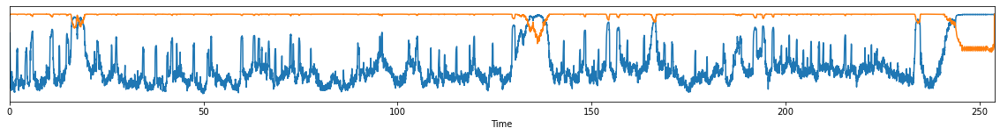

In [40]:
sad_scores = sad(afile)
sad_scores

In [41]:
binarize = Binarize(offset=0.377, onset=0.767, log_scale=True,min_duration_on=0.136, min_duration_off=0.067)
binarize.scale

'absolute'

In [42]:
speech = binarize.apply(sad_scores, dimension=1)
speech.duration()

235.396125

In [43]:
speech.segments_list_

SortedList([<Segment(0.0101563, 16.2945)>, <Segment(17.3998, 17.9922)>, <Segment(19.3472, 133.576)>, <Segment(138.691, 242.981)>])

In [44]:
print()
for i in speech:
    print(i)
    audio, rate = librosa.load("D:/BraveDownloads/Jordan Peterson Confronts Australian Politician on Gender Politics and Quotas _ Q&A.wav", sr = 16000, offset=i.start, duration=i.end-i.start)
    display.display(display.Audio(data=audio.squeeze(), rate=16000, autoplay=False))
    print()


[ 00:00:00.010 -->  00:00:16.294]



[ 00:00:17.399 -->  00:00:17.992]



[ 00:00:19.347 -->  00:02:13.575]



[ 00:02:18.690 -->  00:04:02.981]


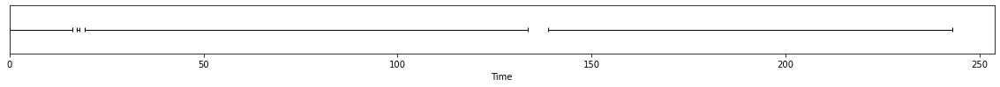

In [45]:
speech

***
## Speaker Change Detection

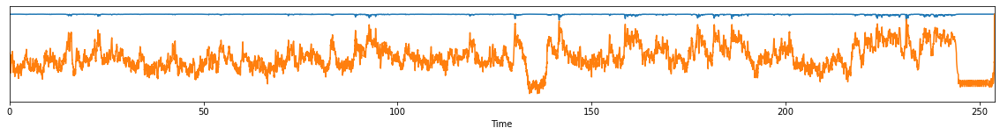

In [46]:
scd_scores = scd(afile)
scd_scores

In [47]:
peak = Peak(alpha=0.7, min_duration=1, scale="percentile")
peak.scale

'percentile'

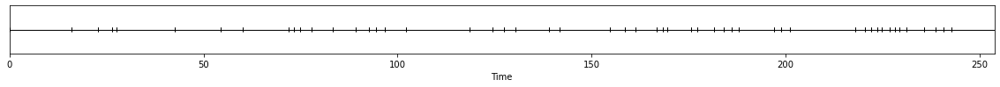

In [48]:
partition = peak.apply(scd_scores, dimension=1)
partition

In [49]:
partition.segments_list_

SortedList([<Segment(0, 15.9132)>, <Segment(15.9132, 22.8201)>, <Segment(22.8201, 26.3588)>, <Segment(26.3588, 27.6683)>, <Segment(27.6683, 42.6752)>, <Segment(42.6752, 54.5097)>, <Segment(54.5097, 60.1122)>, <Segment(60.1122, 71.8656)>, <Segment(71.8656, 73.2055)>, <Segment(73.2055, 74.8339)>, <Segment(74.8339, 77.7415)>, <Segment(77.7415, 83.2275)>, <Segment(83.2275, 89.1473)>, <Segment(89.1473, 92.686)>, <Segment(92.686, 94.3448)>, <Segment(94.3448, 96.6246)>, <Segment(96.6246, 102.18)>, <Segment(102.18, 118.657)>, <Segment(118.657, 124.549)>, <Segment(124.549, 127.42)>, <Segment(127.42, 130.309)>, <Segment(130.309, 139.031)>, <Segment(139.031, 141.639)>, <Segment(141.639, 154.616)>, <Segment(154.616, 158.654)>, <Segment(158.654, 161.264)>, <Segment(161.264, 166.717)>, <Segment(166.717, 168.271)>, <Segment(168.271, 169.427)>, <Segment(169.427, 175.735)>, <Segment(175.735, 177.317)>, <Segment(177.317, 181.597)>, <Segment(181.597, 184.025)>, <Segment(184.025, 186.158)>, <Segment(186.1

In [50]:
print()
for i in partition:
    print(i)
    audio, rate = librosa.load("D:/BraveDownloads/Jordan Peterson Confronts Australian Politician on Gender Politics and Quotas _ Q&A.wav", sr = 16000, offset=i.start, duration=i.end-i.start)
    display.display(display.Audio(data=audio.squeeze(), rate=16000, autoplay=False))
    print()


[ 00:00:00.000 -->  00:00:15.913]



[ 00:00:15.913 -->  00:00:22.820]



[ 00:00:22.820 -->  00:00:26.358]



[ 00:00:26.358 -->  00:00:27.668]



[ 00:00:27.668 -->  00:00:42.675]



[ 00:00:42.675 -->  00:00:54.509]



[ 00:00:54.509 -->  00:01:00.112]



[ 00:01:00.112 -->  00:01:11.865]



[ 00:01:11.865 -->  00:01:13.205]



[ 00:01:13.205 -->  00:01:14.833]



[ 00:01:14.833 -->  00:01:17.741]



[ 00:01:17.741 -->  00:01:23.227]



[ 00:01:23.227 -->  00:01:29.147]



[ 00:01:29.147 -->  00:01:32.685]



[ 00:01:32.685 -->  00:01:34.344]



[ 00:01:34.344 -->  00:01:36.624]



[ 00:01:36.624 -->  00:01:42.179]



[ 00:01:42.179 -->  00:01:58.656]



[ 00:01:58.656 -->  00:02:04.549]



[ 00:02:04.549 -->  00:02:07.419]



[ 00:02:07.419 -->  00:02:10.308]



[ 00:02:10.308 -->  00:02:19.031]



[ 00:02:19.031 -->  00:02:21.638]



[ 00:02:21.638 -->  00:02:34.615]



[ 00:02:34.615 -->  00:02:38.653]



[ 00:02:38.653 -->  00:02:41.264]



[ 00:02:41.264 -->  00:02:46.716]



[ 00:02:46.716 -->  00:02:48.270]



[ 00:02:48.270 -->  00:02:49.426]



[ 00:02:49.426 -->  00:02:55.734]



[ 00:02:55.734 -->  00:02:57.317]



[ 00:02:57.317 -->  00:03:01.596]



[ 00:03:01.596 -->  00:03:04.025]



[ 00:03:04.025 -->  00:03:06.158]



[ 00:03:06.158 -->  00:03:07.893]



[ 00:03:07.893 -->  00:03:16.992]



[ 00:03:16.992 -->  00:03:18.925]



[ 00:03:18.925 -->  00:03:20.991]



[ 00:03:20.991 -->  00:03:37.991]



[ 00:03:37.991 -->  00:03:40.492]



[ 00:03:40.492 -->  00:03:42.009]



[ 00:03:42.009 -->  00:03:43.625]



[ 00:03:43.625 -->  00:03:44.802]



[ 00:03:44.802 -->  00:03:46.783]



[ 00:03:46.783 -->  00:03:48.155]



[ 00:03:48.155 -->  00:03:49.282]



[ 00:03:49.282 -->  00:03:51.057]



[ 00:03:51.057 -->  00:03:55.762]



[ 00:03:55.762 -->  00:03:58.499]



[ 00:03:58.499 -->  00:04:00.720]



[ 00:04:00.720 -->  00:04:02.740]



[ 00:04:02.740 -->  00:04:13.791]


In [51]:
partition.gaps

<bound method Timeline.gaps of <Timeline(uri=None, segments=[<Segment(0, 15.9132)>, <Segment(15.9132, 22.8201)>, <Segment(22.8201, 26.3588)>, <Segment(26.3588, 27.6683)>, <Segment(27.6683, 42.6752)>, <Segment(42.6752, 54.5097)>, <Segment(54.5097, 60.1122)>, <Segment(60.1122, 71.8656)>, <Segment(71.8656, 73.2055)>, <Segment(73.2055, 74.8339)>, <Segment(74.8339, 77.7415)>, <Segment(77.7415, 83.2275)>, <Segment(83.2275, 89.1473)>, <Segment(89.1473, 92.686)>, <Segment(92.686, 94.3448)>, <Segment(94.3448, 96.6246)>, <Segment(96.6246, 102.18)>, <Segment(102.18, 118.657)>, <Segment(118.657, 124.549)>, <Segment(124.549, 127.42)>, <Segment(127.42, 130.309)>, <Segment(130.309, 139.031)>, <Segment(139.031, 141.639)>, <Segment(141.639, 154.616)>, <Segment(154.616, 158.654)>, <Segment(158.654, 161.264)>, <Segment(161.264, 166.717)>, <Segment(166.717, 168.271)>, <Segment(168.271, 169.427)>, <Segment(169.427, 175.735)>, <Segment(175.735, 177.317)>, <Segment(177.317, 181.597)>, <Segment(181.597, 184.0

In [52]:
partition.overlapping

<bound method Timeline.overlapping of <Timeline(uri=None, segments=[<Segment(0, 15.9132)>, <Segment(15.9132, 22.8201)>, <Segment(22.8201, 26.3588)>, <Segment(26.3588, 27.6683)>, <Segment(27.6683, 42.6752)>, <Segment(42.6752, 54.5097)>, <Segment(54.5097, 60.1122)>, <Segment(60.1122, 71.8656)>, <Segment(71.8656, 73.2055)>, <Segment(73.2055, 74.8339)>, <Segment(74.8339, 77.7415)>, <Segment(77.7415, 83.2275)>, <Segment(83.2275, 89.1473)>, <Segment(89.1473, 92.686)>, <Segment(92.686, 94.3448)>, <Segment(94.3448, 96.6246)>, <Segment(96.6246, 102.18)>, <Segment(102.18, 118.657)>, <Segment(118.657, 124.549)>, <Segment(124.549, 127.42)>, <Segment(127.42, 130.309)>, <Segment(130.309, 139.031)>, <Segment(139.031, 141.639)>, <Segment(141.639, 154.616)>, <Segment(154.616, 158.654)>, <Segment(158.654, 161.264)>, <Segment(161.264, 166.717)>, <Segment(166.717, 168.271)>, <Segment(168.271, 169.427)>, <Segment(169.427, 175.735)>, <Segment(175.735, 177.317)>, <Segment(177.317, 181.597)>, <Segment(181.597

In [53]:
partition.segments_boundaries_

SortedList([0.0, 15.91315625, 15.91315625, 22.820093749999998, 22.820093749999998, 26.35878125, 26.35878125, 27.66828125, 27.66828125, 42.67521875, 42.67521875, 54.50965625, 54.50965625, 60.11215625, 60.11215625, 71.86559374999999, 71.86559374999999, 73.20546875, 73.20546875, 74.83390625000001, 74.83390625000001, 77.74146875, 77.74146875, 83.22753125, 83.22753125, 89.14728124999999, 89.14728124999999, 92.68596875, 92.68596875, 94.34478125000001, 94.34478125000001, 96.62459375, 96.62459375, 102.17984375, 102.17984375, 118.65659375000001, 118.65659375000001, 124.54934374999999, 124.54934374999999, 127.41978125, 127.41978125, 130.30878124999998, 130.30878124999998, 139.03146875, 139.03146875, 141.63865625, 141.63865625, 154.61553125, 154.61553125, 158.65371875, 158.65371875, 161.26428124999998, 161.26428124999998, 166.71659375, 166.71659375, 168.27078125, 168.27078125, 169.42671875, 169.42671875, 175.73459375, 175.73459375, 177.31746875, 177.31746875, 181.59696875, 181.59696875, 184.02528

***
## Speech Overlap Detection

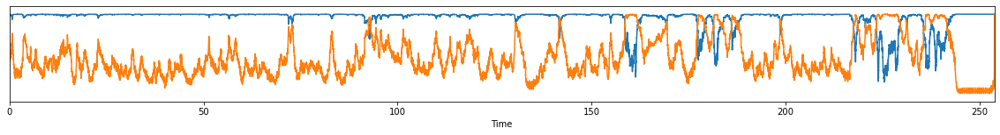

In [54]:
ovl_scores = ovl(afile)
ovl_scores

In [55]:
binarize = Binarize(offset=0.320, onset=0.430, log_scale=True,min_duration_off=0.144, min_duration_on=0.091)

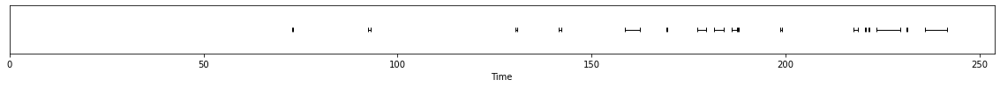

In [56]:
overlap = binarize.apply(ovl_scores, dimension=1)
overlap

In [57]:
overlap.segments_list_

SortedList([<Segment(72.7617, 72.9895)>, <Segment(92.4919, 93.1011)>, <Segment(130.349, 130.854)>, <Segment(141.59, 142.189)>, <Segment(158.534, 162.437)>, <Segment(169.157, 169.433)>, <Segment(177.296, 179.493)>, <Segment(181.492, 183.992)>, <Segment(185.993, 187.55)>, <Segment(187.748, 188.011)>, <Segment(198.511, 198.95)>, <Segment(217.51, 218.676)>, <Segment(220.496, 220.6)>, <Segment(221.375, 221.522)>, <Segment(223.351, 229.596)>, <Segment(231.044, 231.388)>, <Segment(235.992, 241.512)>])

In [58]:
print()
for i in overlap:
    print(i)
    audio, rate = librosa.load("D:/BraveDownloads/Jordan Peterson Confronts Australian Politician on Gender Politics and Quotas _ Q&A.wav", sr = 16000, offset=i.start, duration=i.end-i.start)
    display.display(display.Audio(data=audio.squeeze(), rate=16000, autoplay=False))
    print()


[ 00:01:12.761 -->  00:01:12.989]



[ 00:01:32.491 -->  00:01:33.101]



[ 00:02:10.349 -->  00:02:10.853]



[ 00:02:21.589 -->  00:02:22.188]



[ 00:02:38.533 -->  00:02:42.437]



[ 00:02:49.156 -->  00:02:49.433]



[ 00:02:57.295 -->  00:02:59.492]



[ 00:03:01.492 -->  00:03:03.991]



[ 00:03:05.992 -->  00:03:07.550]



[ 00:03:07.747 -->  00:03:08.011]



[ 00:03:18.510 -->  00:03:18.949]



[ 00:03:37.510 -->  00:03:38.676]



[ 00:03:40.495 -->  00:03:40.600]



[ 00:03:41.374 -->  00:03:41.521]



[ 00:03:43.350 -->  00:03:49.596]



[ 00:03:51.044 -->  00:03:51.388]



[ 00:03:55.991 -->  00:04:01.511]


***
### Speaker Diarization 

In [59]:
speech_turns = speech.crop(overlap)

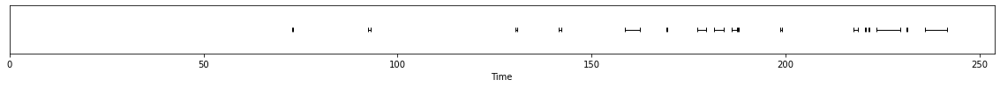

In [60]:
speech_turns

In [61]:
speech_turns.segments_list_

SortedList([<Segment(72.7617, 72.9895)>, <Segment(92.4919, 93.1011)>, <Segment(130.349, 130.854)>, <Segment(141.59, 142.189)>, <Segment(158.534, 162.437)>, <Segment(169.157, 169.433)>, <Segment(177.296, 179.493)>, <Segment(181.492, 183.992)>, <Segment(185.993, 187.55)>, <Segment(187.748, 188.011)>, <Segment(198.511, 198.95)>, <Segment(217.51, 218.676)>, <Segment(220.496, 220.6)>, <Segment(221.375, 221.522)>, <Segment(223.351, 229.596)>, <Segment(231.044, 231.388)>, <Segment(235.992, 241.512)>])

In [62]:
speech_turns = partition.crop(speech)

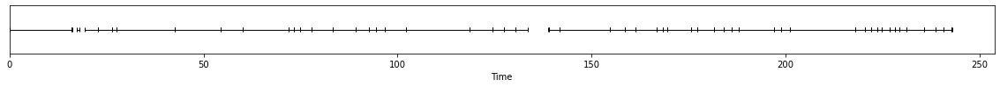

In [63]:
speech_turns

In [64]:
speech_turns.segments_list_

SortedList([<Segment(0.0101563, 15.9132)>, <Segment(15.9132, 16.2945)>, <Segment(17.3998, 17.9922)>, <Segment(19.3472, 22.8201)>, <Segment(22.8201, 26.3588)>, <Segment(26.3588, 27.6683)>, <Segment(27.6683, 42.6752)>, <Segment(42.6752, 54.5097)>, <Segment(54.5097, 60.1122)>, <Segment(60.1122, 71.8656)>, <Segment(71.8656, 73.2055)>, <Segment(73.2055, 74.8339)>, <Segment(74.8339, 77.7415)>, <Segment(77.7415, 83.2275)>, <Segment(83.2275, 89.1473)>, <Segment(89.1473, 92.686)>, <Segment(92.686, 94.3448)>, <Segment(94.3448, 96.6246)>, <Segment(96.6246, 102.18)>, <Segment(102.18, 118.657)>, <Segment(118.657, 124.549)>, <Segment(124.549, 127.42)>, <Segment(127.42, 130.309)>, <Segment(130.309, 133.576)>, <Segment(138.691, 139.031)>, <Segment(139.031, 141.639)>, <Segment(141.639, 154.616)>, <Segment(154.616, 158.654)>, <Segment(158.654, 161.264)>, <Segment(161.264, 166.717)>, <Segment(166.717, 168.271)>, <Segment(168.271, 169.427)>, <Segment(169.427, 175.735)>, <Segment(175.735, 177.317)>, <Segme

In [65]:
speech.segments_list_

SortedList([<Segment(0.0101563, 16.2945)>, <Segment(17.3998, 17.9922)>, <Segment(19.3472, 133.576)>, <Segment(138.691, 242.981)>])

In [66]:
speech_turns=partition.crop(speech.extrude(overlap)).update(overlap)

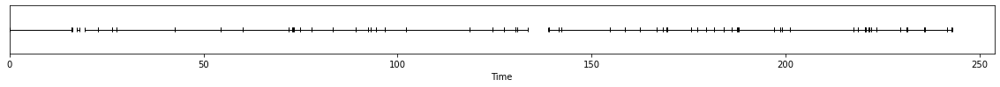

In [67]:
speech_turns

In [68]:
speech_turns.segments_list_

SortedList([<Segment(0.0101563, 15.9132)>, <Segment(15.9132, 16.2945)>, <Segment(17.3998, 17.9922)>, <Segment(19.3472, 22.8201)>, <Segment(22.8201, 26.3588)>, <Segment(26.3588, 27.6683)>, <Segment(27.6683, 42.6752)>, <Segment(42.6752, 54.5097)>, <Segment(54.5097, 60.1122)>, <Segment(60.1122, 71.8656)>, <Segment(71.8656, 72.7617)>, <Segment(72.7617, 72.9895)>, <Segment(72.9895, 73.2055)>, <Segment(73.2055, 74.8339)>, <Segment(74.8339, 77.7415)>, <Segment(77.7415, 83.2275)>, <Segment(83.2275, 89.1473)>, <Segment(89.1473, 92.4919)>, <Segment(92.4919, 93.1011)>, <Segment(93.1011, 94.3448)>, <Segment(94.3448, 96.6246)>, <Segment(96.6246, 102.18)>, <Segment(102.18, 118.657)>, <Segment(118.657, 124.549)>, <Segment(124.549, 127.42)>, <Segment(127.42, 130.309)>, <Segment(130.309, 130.349)>, <Segment(130.349, 130.854)>, <Segment(130.854, 133.576)>, <Segment(138.691, 139.031)>, <Segment(139.031, 141.59)>, <Segment(141.59, 142.189)>, <Segment(142.189, 154.616)>, <Segment(154.616, 158.534)>, <Segme

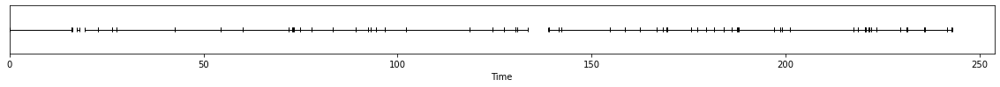

In [69]:
speech_turns.segmentation()

In [70]:
embeddings = emb(afile)
chunks = embeddings.sliding_window
print(f'Embeddings were extracted every {1000 * chunks.step:g}ms on {1000 * chunks.duration:g}ms-long windows.')

Embeddings were extracted every 500ms on 2000ms-long windows.


In [71]:
embeddings.data

array([[-0.00712482, -0.01844717, -0.01220922, ..., -0.01030682,
        -0.00598248, -0.02486262],
       [-0.00931497, -0.00713776, -0.00719075, ..., -0.01301294,
        -0.0012743 , -0.02781408],
       [-0.01148326,  0.00896403, -0.0029086 , ...,  0.01534121,
         0.00601832, -0.01354774],
       ...,
       [ 0.01703126,  0.00156825,  0.00217033, ...,  0.01139834,
         0.012736  , -0.00528309],
       [ 0.01703126,  0.00156825,  0.00217033, ...,  0.01139834,
         0.012736  , -0.00528309],
       [ 0.01703126,  0.00156825,  0.00217033, ...,  0.01139834,
         0.01273601, -0.00528309]], dtype=float32)

In [72]:
embeddings.data.shape

(505, 512)

In [73]:
embeddings.data.max()

0.10207872

In [74]:
embeddings.data.min()

-0.09429916

In [75]:
embeddings.data.sum()

82.679085

In [76]:
cosine(embeddings.data[0],embeddings.data[20])

0.5355560779571533

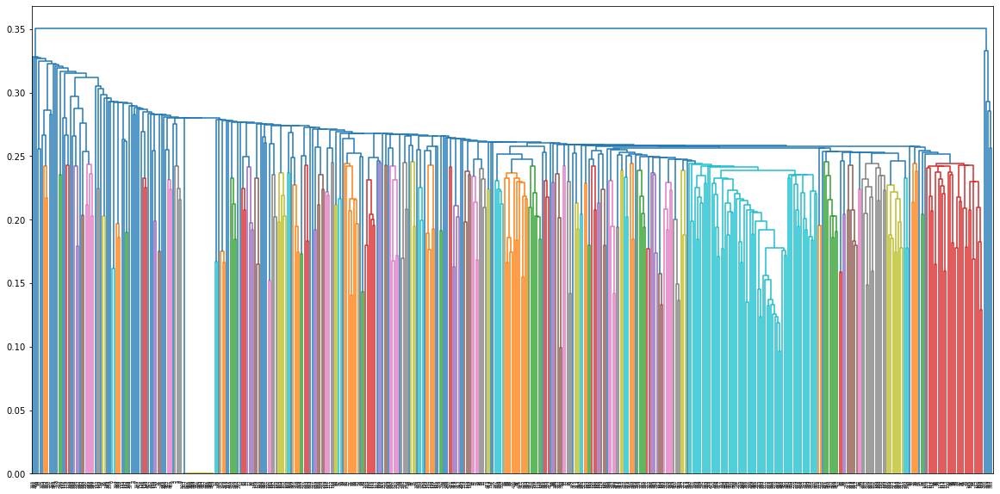

In [77]:
linked = linkage(embeddings.data, 'single')
plt.figure(figsize=(20, 10))
dendrogram(linked)
plt.show()

1.288154285113483


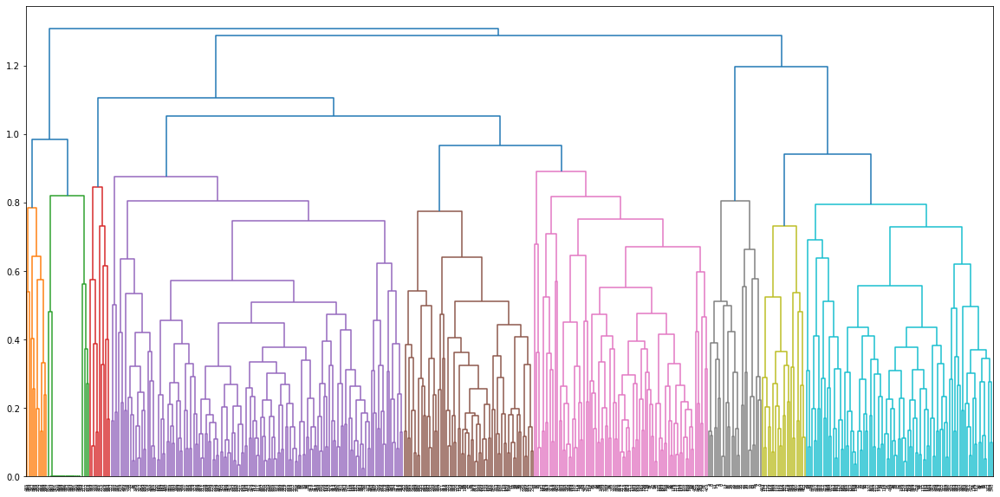

In [78]:
dendro = linkage(
            embeddings.data, method='complete', metric='cosine'
        )

num_clusters=None
min_clusters,max_clusters=2,100
num_embeddings = embeddings.data.shape[0]
max_clusters=min(num_embeddings,max_clusters)

if num_clusters is None:

    max_threshold: float = (
        dendro[-min_clusters, 2]
        if min_clusters < num_embeddings
        else -np.inf
    )
    min_threshold: float = (
        dendro[-max_clusters, 2]
        if max_clusters < num_embeddings
        else -np.inf
    )
    threshold = min(max(min_threshold,2), max_threshold)

else:

    threshold = (
        dendro[-num_clusters, 2]
        if num_clusters < num_embeddings
        else -np.inf
    )
print(threshold)
plt.figure(figsize=(20, 10))
dendrogram(dendro)
plt.show()

In [79]:
cluster = AgglomerativeClustering(affinity='cosine', linkage='complete',distance_threshold=threshold,n_clusters=None)
cluster.fit_predict(embeddings.data)

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 2,
       2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2,
       2, 2, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 2, 0, 2, 2,
       0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 2, 2, 2, 2, 2, 2,
       2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,

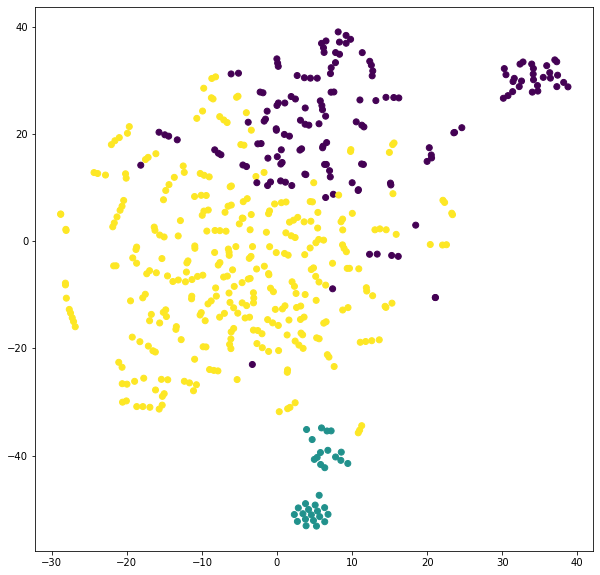

In [80]:
tsne = TSNE(n_components=2, metric="cosine")
X_2d = tsne.fit_transform(embeddings.data)

# plot 
fig, ax = plt.subplots()
fig.set_figheight(10)
fig.set_figwidth(10)
plt.scatter(*X_2d.T, c=cluster.labels_)

0.530173411202187


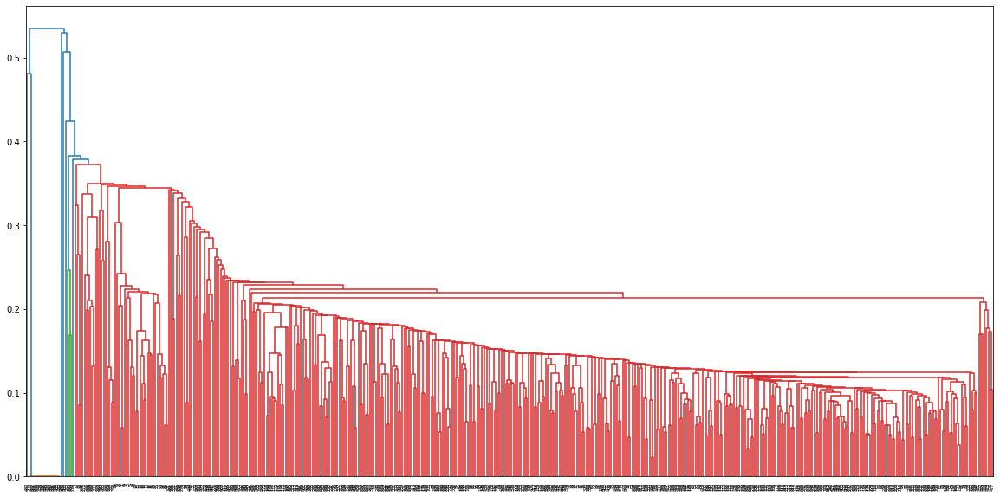

In [81]:
dendro = linkage(
            embeddings.data, method='single', metric='cosine'
        )

num_clusters=None
min_clusters,max_clusters=2,100
num_embeddings = embeddings.data.shape[0]
max_clusters=min(num_embeddings,max_clusters)

if num_clusters is None:

    max_threshold: float = (
        dendro[-min_clusters, 2]
        if min_clusters < num_embeddings
        else -np.inf
    )
    min_threshold: float = (
        dendro[-max_clusters, 2]
        if max_clusters < num_embeddings
        else -np.inf
    )
    threshold = min(max(min_threshold,2), max_threshold)

else:

    threshold = (
        dendro[-num_clusters, 2]
        if num_clusters < num_embeddings
        else -np.inf
    )
print(threshold)
plt.figure(figsize=(20, 10))
dendrogram(dendro)
plt.show()

In [82]:
cluster = AgglomerativeClustering(affinity='cosine', linkage='single',distance_threshold=threshold,n_clusters=None)
cluster.fit_predict(embeddings.data)

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

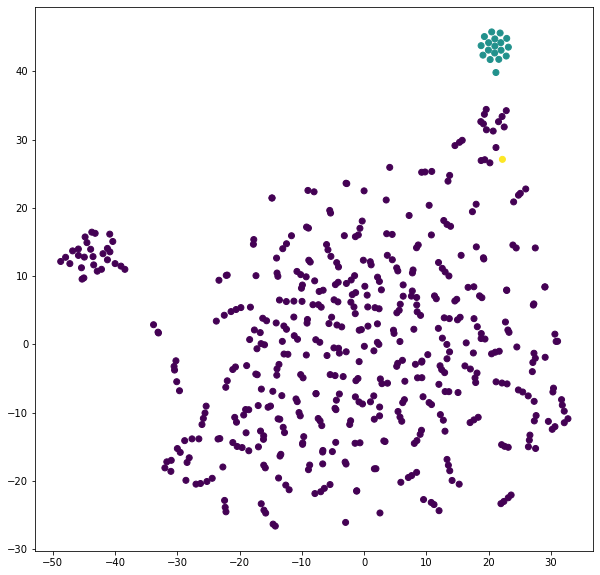

In [83]:
tsne = TSNE(n_components=2, metric="cosine")
X_2d = tsne.fit_transform(embeddings.data)

# plot 
fig, ax = plt.subplots()
fig.set_figheight(10)
fig.set_figwidth(10)
plt.scatter(*X_2d.T, c=cluster.labels_)

0.8221321279437557


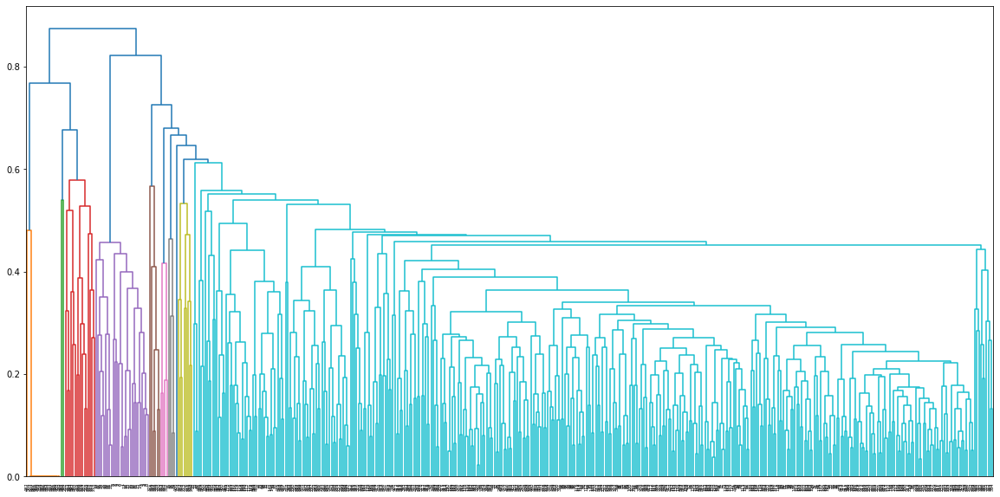

In [84]:
dendro = linkage(
            embeddings.data, method='average', metric='cosine'
        )

num_clusters=None
min_clusters,max_clusters=2,100
num_embeddings = embeddings.data.shape[0]
max_clusters=min(num_embeddings,max_clusters)

if num_clusters is None:

    max_threshold: float = (
        dendro[-min_clusters, 2]
        if min_clusters < num_embeddings
        else -np.inf
    )
    min_threshold: float = (
        dendro[-max_clusters, 2]
        if max_clusters < num_embeddings
        else -np.inf
    )
    threshold = min(max(min_threshold,2), max_threshold)

else:

    threshold = (
        dendro[-num_clusters, 2]
        if num_clusters < num_embeddings
        else -np.inf
    )
print(threshold)
plt.figure(figsize=(20, 10))
dendrogram(dendro)
plt.show()

In [85]:
cluster = AgglomerativeClustering(affinity='cosine', linkage='average',distance_threshold=threshold,n_clusters=None)
cluster.fit_predict(embeddings.data)

array([2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

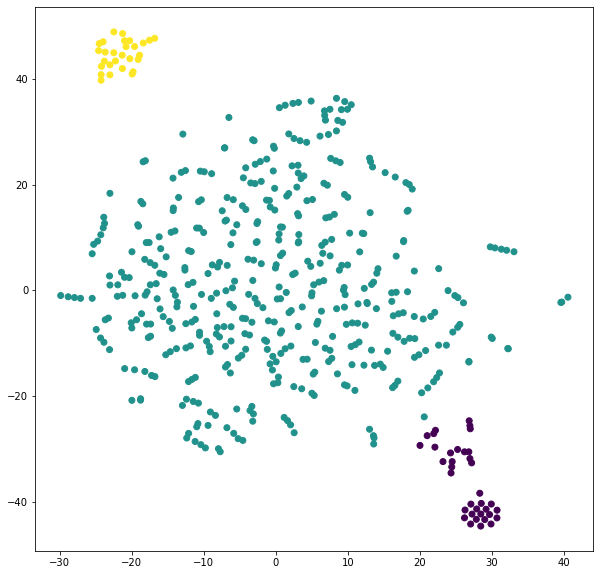

In [86]:
tsne = TSNE(n_components=2, metric="cosine")
X_2d = tsne.fit_transform(embeddings.data)

# plot 
fig, ax = plt.subplots()
fig.set_figheight(10)
fig.set_figwidth(10)
plt.scatter(*X_2d.T, c=cluster.labels_)

In [87]:
X,Final_Turns=[],[]
for segment in speech_turns:
    # "strict" only keeps embedding strictly included in segment
    x = embeddings.crop(segment, mode='strict')
    # average speech turn embedding
    if len(x)>0:
        X.append(np.mean(x, axis=0))
        Final_Turns.append(segment)

X = np.vstack(X)

In [88]:
X,Final_Turns=[],[]
for segment in speech_turns:
    # "strict" only keeps embedding strictly included in segment
    x = embeddings.crop(segment, mode='strict')
    # average speech turn embedding
    if len(x)>0:
        X.append(np.mean(x, axis=0))
        Final_Turns.append(segment)

X = np.vstack(X)

In [89]:
X

array([[-0.00374429,  0.0008007 , -0.01573993, ...,  0.00841459,
         0.00554034, -0.00293594],
       [ 0.01151661,  0.02905653,  0.00309585, ...,  0.03608445,
         0.02902702,  0.01503893],
       [-0.00516958,  0.02548374,  0.00535719, ...,  0.02892278,
         0.02115323,  0.02866939],
       ...,
       [ 0.0004743 ,  0.00590783,  0.00678481, ...,  0.01846204,
         0.01219903,  0.0144756 ],
       [-0.00914989, -0.00926899,  0.02255129, ...,  0.01147455,
         0.01676281,  0.01510179],
       [-0.00770161,  0.01387357,  0.01669338, ...,  0.02046775,
         0.01294266,  0.00554194]], dtype=float32)

In [90]:
dendro = linkage(
            X, method='average', metric='cosine'
        )

num_clusters=None
min_clusters,max_clusters=2,100
threshold=2
num_embeddings = len(X)
max_clusters=min(num_embeddings,max_clusters)
if num_clusters is None:

    max_threshold: float = (
        dendro[-min_clusters, 2]
        if min_clusters < num_embeddings
        else -np.inf
    )
    min_threshold: float = (
        dendro[-max_clusters, 2]
        if max_clusters < num_embeddings
        else -np.inf
    )
    threshold = min(max(min_threshold,2), max_threshold)

else:

    threshold = (
        dendro[-num_clusters, 2]
        if num_clusters < num_embeddings
        else -np.inf
    )

In [91]:
cluster = AgglomerativeClustering(affinity='cosine', linkage='average',distance_threshold=threshold,n_clusters=None)
cluster.fit_predict(X)

array([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0], dtype=int64)

In [92]:
from spectralcluster import SpectralClusterer
from spectralcluster import EigenGapType, LaplacianType, SpectralClusterer
from spectralcluster import AutoTune
from spectralcluster import RefinementOptions
from spectralcluster import ThresholdType
from spectralcluster import ICASSP2018_REFINEMENT_SEQUENCE

clusterer = SpectralClusterer(
    min_clusters=2,
    max_clusters=100,
    laplacian_type=LaplacianType["Unnormalized"],
    custom_dist="cosine")

labels = clusterer.predict(X)

In [93]:
labels

array([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0], dtype=int64)

In [94]:
Final_Turns

[<Segment(0.0101563, 15.9132)>,
 <Segment(19.3472, 22.8201)>,
 <Segment(22.8201, 26.3588)>,
 <Segment(27.6683, 42.6752)>,
 <Segment(42.6752, 54.5097)>,
 <Segment(54.5097, 60.1122)>,
 <Segment(60.1122, 71.8656)>,
 <Segment(74.8339, 77.7415)>,
 <Segment(77.7415, 83.2275)>,
 <Segment(83.2275, 89.1473)>,
 <Segment(89.1473, 92.4919)>,
 <Segment(94.3448, 96.6246)>,
 <Segment(96.6246, 102.18)>,
 <Segment(102.18, 118.657)>,
 <Segment(118.657, 124.549)>,
 <Segment(124.549, 127.42)>,
 <Segment(127.42, 130.309)>,
 <Segment(130.854, 133.576)>,
 <Segment(139.031, 141.59)>,
 <Segment(142.189, 154.616)>,
 <Segment(154.616, 158.534)>,
 <Segment(158.534, 162.437)>,
 <Segment(162.437, 166.717)>,
 <Segment(169.433, 175.735)>,
 <Segment(181.492, 183.992)>,
 <Segment(188.011, 196.992)>,
 <Segment(200.991, 217.51)>,
 <Segment(223.351, 229.596)>,
 <Segment(231.388, 235.762)>,
 <Segment(235.992, 241.512)>]

In [95]:
puncts={".",",","?","!"}
j,k,last=0,0,0
print()
for i in Final_Turns:
    audio, rate = librosa.load("D:/BraveDownloads/Jordan Peterson Confronts Australian Politician on Gender Politics and Quotas _ Q&A.wav", sr = 16000, offset=i.start, duration=i.end-i.start)
    try:
        if j!=0 and round(Final_Turns[j].start-Final_Turns[j-1].end)>0:
            print("[Pause] "+str(round(Final_Turns[j].start-Final_Turns[j-1].end))+" second(s)\n")
        
        input_values = pro_960h_processor(audio, return_tensors="pt", padding="longest", sampling_rate=rate).input_values
        with torch.no_grad():
            logits = pro_960h_model(input_values).logits
        prediction = torch.argmax(logits, dim = -1)
        transcription = pro_960h_processor.batch_decode(prediction)[0].lower()
        
        grammchange=False
        if len(transcription)<500:
            processed_transcription = p2.punctuate(parser.parse(transcription)['result']) if transcription != None else "[NOISE]"
        else:
            processed_transcription = p2.punctuate(transcription)
            grammchange=True
        
        s=1
        while s < len(processed_transcription): 
            if processed_transcription[s-1] in puncts and processed_transcription[s] in puncts: 
                processed_transcription = processed_transcription[:s]+processed_transcription[s+1:] if (s < (len(processed_transcription)-1)) else processed_transcription[:s]
                continue
            s+=1
        if grammchange:
            transcriptions=processed_transcription.split(".")
            for s in range(len(transcriptions)): 
                transcriptions[s] = parser.parse(transcriptions[s])['result']
            processed_transcription = ".".join(transcriptions)
            processed_transcription = processed_transcription[:len(processed_transcription)]
        print(i,"\n")
        while k<len(overlap) and Final_Turns[j]>=overlap.segments_list_[k]:
            if Final_Turns[j].intersects(overlap.segments_list_[k]):
                print("[Overlapping Conversations]\n")
                k+=1
                break
            k+=1
        if j==0 or cluster.labels_[j]!=last:
            print("Speaker "+str(cluster.labels_[j]+1)+" :  " + processed_transcription)
        else:
            print(processed_transcription)

        last=cluster.labels_[j]
    except Exception as e:
        if len(str(e))<100:
            print(e)
        print("[NOISE/Overlapping Conversations]")
        last=-1
    display.display(display.Audio(data=audio.squeeze(), rate=16000, autoplay=False))
    print()
    j+=1


[ 00:00:00.010 -->  00:00:15.913] 

Speaker 2 :  Martin Luther king's dream was that there would come a time when people would not be judged by the color of their skin, but by the content of their character, how is in a day's identity politics, consistent with that vision, John Peterson.



[Pause] 3 second(s)

[ 00:00:19.347 -->  00:00:22.820] 

Speaker 1 :  I don't think, it's consistent with that vision at all mean,



[ 00:00:22.820 -->  00:00:26.358] 

The problem I have identity politics as a.



[Pause] 1 second(s)

[ 00:00:27.668 -->  00:00:42.675] 

Philosophical apprehension is that it's predicated on the idea that the appropriate way to classify people is by their group identity in whatever fragmentary formulation that might take in the multiplicity of ways that people can be divided into groups. And that.



[ 00:00:42.675 -->  00:00:54.509] 

E, classical post, modern and I would also say, mark's way of viewing the world, even though those two things shouldn't be allowed together. They tend to be is that group identity takes priority over in.



[ 00:00:54.509 -->  00:01:00.112] 

Dual identity and I think that's precisely the opposite of what martin Luther Kane was hoping for and working for.



[ 00:01:00.112 -->  00:01:11.865] 

Di thinks it's unbelievably dangerous because partly, because when you when you assume that people should primarily be identified by their group, then you can also attribute.



[Pause] 3 second(s)

[ 00:01:14.833 -->  00:01:17.741] 

And then things go downhill, very, very rapidly,



[ 00:01:17.741 -->  00:01:23.227] 

And we've had no shortage of evidence of that sort of thing happening say throughout the twentieth century at the.



[ 00:01:23.227 -->  00:01:29.147] 

A groups that you are more concerned about than others, For example, the liberal party as terry butler said earlier,



[ 00:01:29.147 -->  00:01:32.491] 

Is a group I other groups that you think I'm?



[Pause] 2 second(s)

[ 00:01:34.344 -->  00:01:36.624] 

Groups, the.



[ 00:01:36.624 -->  00:01:42.179] 

Is by assuming that the fundamental way that you should categorize people is with their group.



[ 00:01:42.179 -->  00:01:58.656] 

Identity obviously, we all belong to groups. The issue is whether not the individual identity is primary. And the group identity is secondary or the group identity is primary and the individual identity is secondary. If you're a proponent for example of equality of outcome,



[ 00:01:58.656 -->  00:02:04.549] 

Of quotas, then you do fact, accept the proposition that it's the group identity that is primary.



[ 00:02:04.549 -->  00:02:07.419] 

And there's all sorts of dangers that are associated with that.



[ 00:02:07.419 -->  00:02:10.308] 

Outweigh whatever good you're likely to do.



[Pause] 1 second(s)

[NOISE/Overlapping Conversations]



[Pause] 5 second(s)

[ 00:02:19.031 -->  00:02:21.589] 

Speaker 1 :  The, you just think that representative democracy should be.



[Pause] 1 second(s)

[ 00:02:22.188 -->  00:02:34.615] 

Maybe you just think that women should be equally represented in the decision, making fora of our nation, maybe that's really just about having proper equality in a body that's meant to be representative.



[ 00:02:34.615 -->  00:02:38.533] 

Well, I do believe that women should have, I didn't understand your quest.



[ 00:02:38.533 -->  00:02:42.437] 

[Overlapping Conversations]

I was, now, I guess you're dying that's page. Thank as well. How about it four pros.



[ 00:02:42.437 -->  00:02:46.716] 

It more clearly, instead of just insulting me.



[Pause] 3 second(s)

[ 00:02:49.433 -->  00:02:55.734] 

About quotas for a minute so there's, a very wide array of jobs that are fundamentally a.



[Pause] 6 second(s)

[ 00:03:01.492 -->  00:03:03.991] 

[Overlapping Conversations]

Sorry, oiler itself, sledging, I, online.



[Pause] 4 second(s)

[ 00:03:08.011 -->  00:03:16.992] 

Ninety nine point nine percent of bricklayers are men. Should we have quarters for women is bricklaying representative. Democracy.



[Pause] 4 second(s)

[ 00:03:20.991 -->  00:03:37.510] 

There's evidence of structural inequality and oppression because women aren't precisely represented fifty per cent in all professions at all levels, Then why don't we have a conversation about having women represented in all professions at all.



[Pause] 6 second(s)

[ 00:03:43.350 -->  00:03:49.596] 

[Overlapping Conversations]

Why don't we talk about it across t, the bunebagery well, it's, just fashion and but that's because I do I power if you?



[Pause] 2 second(s)

[ 00:03:51.388 -->  00:03:55.762] 

Go ahead and answer it, then we'll hear from the other palace. His question to me.



[ 00:03:55.991 -->  00:04:01.511] 

[Overlapping Conversations]

About reclas you'd like to answer the question about bricks, there's, nothing wrong with brickinr. An teclots is not my.


In [96]:
class SpeakerDiarization:
    pro_960h_processor = Wav2Vec2Processor.from_pretrained("facebook/wav2vec2-large-960h-lv60-self",cache_dir="D:\\Study\\Sem7\\Final Year\\cache\\models\\pro-960h")
    pro_960h_model = Wav2Vec2ForCTC.from_pretrained("facebook/wav2vec2-large-960h-lv60-self",cache_dir="D:\\Study\\Sem7\\Final Year\\cache\\models\\pro-960h")
    parser = GingerIt()
    p = Punctuator('D:/Study/Sem7/Final Year/Transcription/.punctuator/Demo-Europarl-EN.pcl')
    sad = torch.hub.load('pyannote/pyannote-audio', 'sad_ami')
    scd = torch.hub.load('pyannote/pyannote-audio', 'scd_ami')
    emb = torch.hub.load('pyannote/pyannote-audio', 'emb_ami')
    ovl = torch.hub.load('pyannote/pyannote-audio', 'ovl_ami')
    
    def __init__(self, audio_file,show_graphs=True,sampling_rate=16000,j=0,k=0,last=0):
        self.afile = audio_file
        self.output=[""]
        self.speakerDiarization(show_graphs,sampling_rate,j,k,last)
        button_download = widgets.Button(description = 'Download Files')   
        button_download.on_click(self.download)
        display.display(button_download)
        
    def speechToText(self,audio,sampling_rate=16000):
        if audio is None or len(audio)<=0:
            return None
        input_values = self.pro_960h_processor(audio, return_tensors="pt", padding="longest", sampling_rate=sampling_rate).input_values
        with torch.no_grad():
            logits = self.pro_960h_model(input_values).logits
        prediction = torch.argmax(logits, dim = -1)
        return self.pro_960h_processor.batch_decode(prediction)[0].lower()
    
    def punctuate(self,text):
        return self.p.punctuate(text)
    
    def grammar(self,text):
        return self.parser.parse(text)['result']
    
    def processing(self,text):
        puncts={".",",","?","!"}
        s=1
        while s < len(text): 
            if text[s-1] in puncts and text[s] in puncts: 
                text = text[:s]+text[s+1:] if (s < (len(text)-1)) else text[:s]
                continue
            s+=1
        return text
    
    def longProcessing(self,text,split="."):
        transcriptions=text.split(split)
        for s in range(len(transcriptions)):
            if len(transcriptions[s])<500:
                transcriptions[s] = self.grammar(transcriptions[s])
            else:
                try:
                    transcriptions[s] = self.grammar(self.longProcessing(transcriptions[s],","))
                except:
                    continue
        if split==".":
            processed_transcription = ".".join(transcriptions)
        else:
            processed_transcription = ",".join(transcriptions)
        return processed_transcription[:len(processed_transcription)]
    
    def download(self,b):
        root = Tk()
        root.withdraw()
        root.call('wm', 'attributes', '.', '-topmost', True)
        b.folder = filedialog.askdirectory() 
        pdf = fpdf.FPDF()

        # Add a page
        pdf.add_page()

        # set style and size of font 
        # that you want in the pdf
        
        pdf.set_font('Helvetica','B',16)

        # create a cell
        pdf.cell(200, 10, txt = "Transcription Report", 
             ln = 1, align = 'C')

        # add another cell
        
        pdf.set_font("Helvetica", size = 12)
        pdf.cell(200, 10, txt = self.afile,ln = 2, align = 'C')
        
        pdf.set_font("Helvetica", size = 10)
        for i in range(len(self.partitionList)):
            audio, rate = librosa.load(self.afile, sr = 16000, offset=self.partitionList[i].start, duration=self.partitionList[i].end-self.partitionList[i].start)
            pdf.multi_cell(0, 10, txt = self.output[i], border = 0, align = 'L')
            link=b.folder+'/AudioExcerpt'+f'{i:03d}'+'.wav'
            sf.write(link, audio,rate, 'PCM_24')
            pdf.cell(200, 10, txt = "Audio excerpt at: "+link,ln = 2, align = 'L',link=link)
        path = (b.folder+"/Report.pdf");
        print(path)
        pdf.output(path,"F")
            
        
    
    def speakerDiarization(self,show_graphs,sampling_rate,j,k,last):
        print("\n[ Performing Segmentation ]")
        f = widgets.IntProgress(value=0,min=0,max=5,description='Processes:',bar_style='success',style={'bar_color': 'green'},orientation='horizontal')
        display.display(f)
        bfile = {'audio': self.afile}
        
        peak = Peak(alpha=0.7, min_duration=1, scale="relative")
        
        binarizeVAD = Binarize(offset=0.377, onset=0.767, log_scale=True,min_duration_on=0.136, min_duration_off=0.067)
        binarizeSOD = Binarize(offset=0.320, onset=0.430, log_scale=True,min_duration_off=0.144, min_duration_on=0.091)
        
        scd_scores = self.scd(bfile)
        f.value += 1
        sad_scores = self.sad(bfile)
        f.value += 1
        ovl_scores = self.ovl(bfile)
        f.value += 1

        speech = binarizeVAD.apply(sad_scores, dimension=1)
        partition = peak.apply(scd_scores, dimension=1)
        overlap = binarizeSOD.apply(ovl_scores, dimension=1)
        
        speech_turns = partition.crop(speech.extrude(overlap)).update(overlap)
        f.value += 1
        
        embeddings = self.emb(bfile)
        f.value += 1
        
        print("\n[ Printing Segment Information ]\n")
        print(speech.segments_list_,"\n")
        print(partition.segments_list_,"\n")
        print(overlap.segments_list_,"\n")
        print(speech_turns.segments_list_,"\n")
        
        print("\n[ Performing Clustering ]\n")
        
        cluster = AgglomerativeClustering(affinity='cosine', linkage='average')
        y=cluster.fit_predict(embeddings.data)
        tsne = TSNE(n_components=2, metric="cosine")
        X_2d = tsne.fit_transform(embeddings.data)

        # plot 
        fig, ax = plt.subplots()
        fig.set_figheight(10)
        fig.set_figwidth(10)
        plt.scatter(*X_2d.T, c=cluster.labels_)
        
        X,Final_Turns=[],[]
        for segment in speech_turns:
            # "strict" only keeps embedding strictly included in segment
            x = embeddings.crop(segment, mode="center", fixed=segment.duration)
            # average speech turn embedding
            if len(x)>0:
                X.append(np.mean(x, axis=0))
                Final_Turns.append(segment)
        X = np.vstack(X)
        
        dendro = linkage(
            X, method='average', metric='cosine'
        )

        num_clusters=None
        min_clusters,max_clusters=2,100
        threshold=2
        num_embeddings = len(X)
        max_clusters=min(num_embeddings,max_clusters)
        if num_clusters is None:

            max_threshold: float = (
                dendro[-min_clusters, 2]
                if min_clusters < num_embeddings
                else -np.inf
            )
            min_threshold: float = (
                dendro[-max_clusters, 2]
                if max_clusters < num_embeddings
                else -np.inf
            )
            threshold = min(max(min_threshold,threshold), max_threshold)

        else:

            threshold = (
                dendro[-num_clusters, 2]
                if num_clusters < num_embeddings
                else -np.inf
            )
        print(threshold)
        
        cluster = AgglomerativeClustering(affinity='cosine', linkage='average',distance_threshold=threshold,n_clusters=None)
        y=cluster.fit_predict(X)
        
        print(y)
        
        speech_turns,last=Final_Turns,-1
        Final_Turns,cluster.labels_=[],[]
        print(speech_turns)
        
        for i in range(0,len(speech_turns)-1):
            
            if i==(len(speech_turns)-2):
                if last==-1:
                    if y[i+1]==y[i] and speech_turns[i].end==speech_turns[i+1].start:
                        Final_Turns.append(Segment(start=speech_turns[i].start, end=speech_turns[i+1].end))
                        cluster.labels_.append(y[i+1])
                    else:
                        Final_Turns.extend(speech_turns[-2:])
                        cluster.labels_.append(y[-2])
                    break
                if y[i+1]==y[i] and speech_turns[i].end==speech_turns[i+1].start:
                    Final_Turns.append(Segment(start=speech_turns[last].start, end=speech_turns[-1].end))
                    cluster.labels_.append(y[i+1])
                else:
                    Final_Turns.append(Segment(start=speech_turns[last].start, end=speech_turns[i].end))
                    Final_Turns.append(speech_turns[-1])
                    cluster.labels_.append(y[-2])
            elif y[i+1]==y[i] and speech_turns[i].end==speech_turns[i+1].start:
                    if last==-1:
                        last=i
                    continue
            elif last!=-1:
                Final_Turns.append(Segment(start=speech_turns[last].start, end=speech_turns[i].end))
                cluster.labels_.append(y[i])
                last=-1
            else:
                Final_Turns.append(speech_turns[i])
                cluster.labels_.append(y[i])
                last=-1
          
        print(Final_Turns)      
#         X=[]
#         for segment in Final_Turns:
#             # "strict" only keeps embedding strictly included in segment
#             x = embeddings.crop(segment, mode="center", fixed=segment.duration)
#             # average speech turn embedding
#             if len(x)>0:
#                 X.append(np.mean(x, axis=0))
#         X = np.vstack(X) 
        
        self.partitionList=Final_Turns
        
        if show_graphs:
            print("Voice Activity Detection:")
            display.display(sad_scores)
            display.display(speech)
            
            print("Speaker Change Detection:")
            display.display(scd_scores)
            display.display(partition)
            
            print("Speech Overlap Detection:")
            display.display(ovl_scores)
            display.display(overlap)
            
            print("Dendogram:")
            
            plt.figure(figsize=(20, 10))
            dendrogram(dendro)
            plt.show()
            
            print("Speech Clusters:")
            tsne = TSNE(n_components=2, metric="cosine")
            X_2d = tsne.fit_transform(X)

            # plot 
            fig, ax = plt.subplots()
            fig.set_figheight(10)
            fig.set_figwidth(10)
            plt.scatter(*X_2d.T, c=y)
            plt.show()
            
        print()
        for i in Final_Turns:
            audio, rate = librosa.load(self.afile, sr = sampling_rate, offset=i.start, duration=i.end-i.start)
            try:
                if j!=0 and round(Final_Turns[j].start-Final_Turns[j-1].end)>0:
                    print("[Pause] "+str(round(Final_Turns[j].start-Final_Turns[j-1].end))+" second(s)\n")
                    self.output[-1]+="\n[Pause] "+str(round(Final_Turns[j].start-Final_Turns[j-1].end))+" second(s)\n\n"
        
                transcription=self.speechToText(audio,sampling_rate=rate)
                if len(transcription)<500:
                    processed_transcription = self.punctuate(self.grammar(transcription)) if transcription != None else "[NOISE]"
                else:
                    processed_transcription = self.longProcessing(self.punctuate(transcription))
                      
                processed_transcription = self.processing(processed_transcription)
                
                self.output[-1]+="\n"+str(i)+"\n"
                print(i,"\n")
                while k<len(overlap) and Final_Turns[j]>=overlap.segments_list_[k]:
                    if Final_Turns[j].intersects(overlap.segments_list_[k]):
                        print("[Overlapping Conversations]\n")
                        self.output[-1]+="\n[Overlapping Conversations]\n"
                        k+=1
                        break
                    k+=1
                if j==0 or cluster.labels_[j]!=last:
                    print("Speaker "+str(cluster.labels_[j]+1)+" :  " + processed_transcription)
                    self.output[-1]+="Speaker "+str(cluster.labels_[j]+1)+" :  " + processed_transcription+"\n"
                else:
                    print(processed_transcription)
                    self.output[-1]+=processed_transcription+"\n"

                last=cluster.labels_[j]
            except Exception as e:
                if len(str(e))<100:
                    print(e)
                print("[NOISE/Overlapping Conversations]")
                self.output[-1]+="[NOISE/Overlapping Conversations]\n"
                last=-1
            display.display(display.Audio(data=audio.squeeze(), rate=16000, autoplay=False))
            self.output.append("")
            print()
            j+=1

Some weights of Wav2Vec2ForCTC were not initialized from the model checkpoint at facebook/wav2vec2-large-960h-lv60-self and are newly initialized: ['wav2vec2.masked_spec_embed']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
Using cache found in C:\Users\dhiva/.cache\torch\hub\pyannote_pyannote-audio_master
Using cache found in C:\Users\dhiva/.cache\torch\hub\pyannote_pyannote-audio_master
Using cache found in C:\Users\dhiva/.cache\torch\hub\pyannote_pyannote-audio_master
Using cache found in C:\Users\dhiva/.cache\torch\hub\pyannote_pyannote-audio_master


In [99]:
begin = time.time()
sd=SpeakerDiarization("D:/BraveDownloads/8q7vg-909qk.wav")
end = time.time()
end-begin


[ Performing Segmentation ]


IntProgress(value=0, bar_style='success', description='Processes:', max=5, style=ProgressStyle(bar_color='gree…

KeyboardInterrupt: 